# Matematikai Programcsomagok

## 5. Előadás: Vizualizáció
### 2025 március 11.

## Adatvizualizáció  

Fontos, hogy az adatokat informatív módon tudjuk prezentálni mások (és persze magunk) számára. 



<img src="https://i.redd.it/cjysv8jznu651.png" alt="Drawing" style="width: 1000px;"/>

![mis](misleading1.jpg)

![mis](misleading2.jpg)

![mis](nomasksgraph.jpg)

![mis](nomasksgraphfunny.jpg)

![mis](Deathsclutter.png)

In [4]:
import numpy as np
import random as rn
import matplotlib.pyplot as plt
import csv                            # csv fájlból fogunk beolvasni adatokat. 


# Matplotlib
- A legismertebb grafikon és ábra készítő Pythonban. 
- Példákon keresztül nézzük meg a működését.

# New Yorki mókusok
Az adatok egy csv (comma separated values) fájlban vannak, a honlapon megtalálható. Minden sor egy mókus észlelés adatait írja le a Central Parkban. Az első sorból látszik, hogy milyen adatok vannak megadva észlelésenként: 

long,lat,unique_squirrel_id,hectare,shift,date,hectare_squirrel_number,age,primary_fur_color,highlight_fur_color,
combination_of_primary_and_highlight_color,color_notes,location,above_ground_sighter_measurement,specific_location,running,
chasing,climbing,eating,foraging,other_activities,kuks,quaas,moans,tail_flags,tail_twitches,approaches,indifferent,runs_from,
other_interactions,lat_long,zip_codes,community_districts,borough_boundaries,city_council_districts,police_precincts

Először készítünk egy függvényt, ami beolvas egy oszlopot:

In [5]:
def getcolumn(fajlnev, ind):      # egy oszlop beolvasása egy cvs fájlból, de legfeljebb 3000 elem. 
    ans=[]
    c=0
    with open(fajlnev, newline='') as csvfile:
        sqreader = csv.reader(csvfile, delimiter=',', quotechar='"')
        ans=[next(sqreader)[ind] for _ in range(3000)]
        del ans[0]
        return ans
    return ans 

In [6]:
getcolumn('nyc_squirrels.csv',7)[0:10] # első 10 mókus kora

['NA',
 'Adult',
 'Adult',
 'Juvenile',
 'NA',
 'Juvenile',
 'Adult',
 'NA',
 'Adult',
 'Adult']

In [7]:
a=getcolumn('nyc_squirrels.csv',7)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True)           # A tömbben előforduló egyedei objektumok és hogy hányszor 
                                                              # fordulnak elő

In [8]:
print(unique)
print(counts)

['?' 'Adult' 'Juvenile' 'NA']
[   4 2550  327  118]


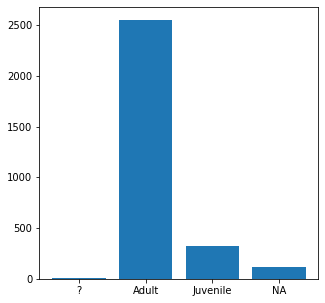

In [9]:
a=getcolumn('nyc_squirrels.csv',7)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True) 

fig, axs = plt.subplots(1, 1, figsize=(5, 5))   # méret és grafikonok száma
axs.bar(unique,counts)
plt.show()


<img src="https://matplotlib.org/_images/anatomy.png" alt="Drawing" style="width: 850px;"/>

<img src="ch10_figure_anatomy_2.webp" alt="Drawing" style="width: 850px;"/>

### Több grafikon egymás mellett
A matplotlibet kétféle stílusban lehet használni. Mi az objektum orientált stílust fogjuk követni, ez az ajánlott. 

Egy képen belül több grafikon van, amit `axes`-nek hívunk. (Nem összekeverendő az `axis` szóval, ami tengelyt jelent!) Amelyikre kiadjuk a parancsot, arra rajzolunk. 

(A másik stílus az volna, hogy mindig plt.parancs formában adjuk ki a rajzoló parancsokat és egy külön parancsal állítjuk be, hogy éppen melyik grafikonra rajzolunk)

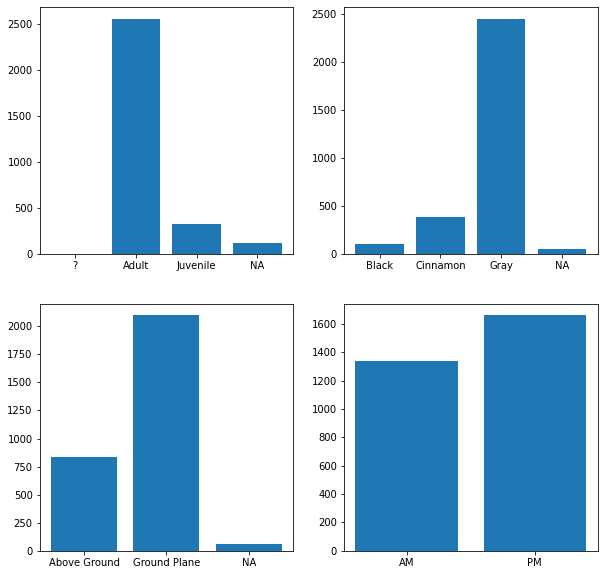

In [10]:
fig, axs = plt.subplots(2, 2, figsize=(10, 10))

a=getcolumn('nyc_squirrels.csv',7)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True)
axs[0, 0].bar(unique,counts)

a=getcolumn('nyc_squirrels.csv',8)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True)
axs[0, 1].bar(unique,counts)

a=getcolumn('nyc_squirrels.csv',12)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True)
axs[1, 0].bar(unique,counts)

a=getcolumn('nyc_squirrels.csv',4)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True)
axs[1, 1].bar(unique,counts)


plt.show()

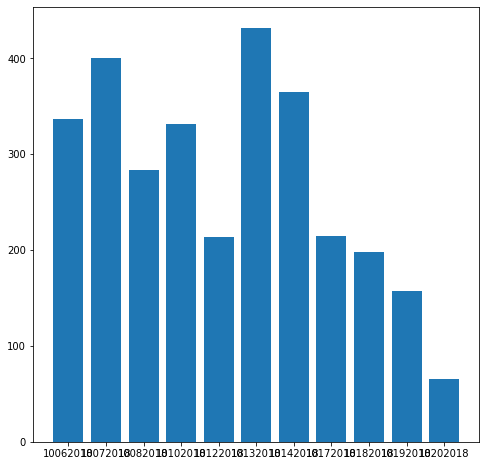

In [11]:
a=getcolumn('nyc_squirrels.csv',5)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True)

fig, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.bar(unique,counts)
plt.show()

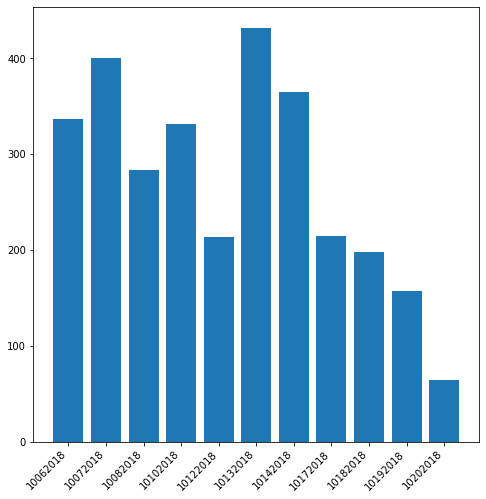

In [12]:
a=getcolumn('nyc_squirrels.csv',5)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True)

fig, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.bar(unique,counts)
labels = axs.get_xticklabels()
plt.setp(labels, rotation=45, horizontalalignment='right')
plt.show()

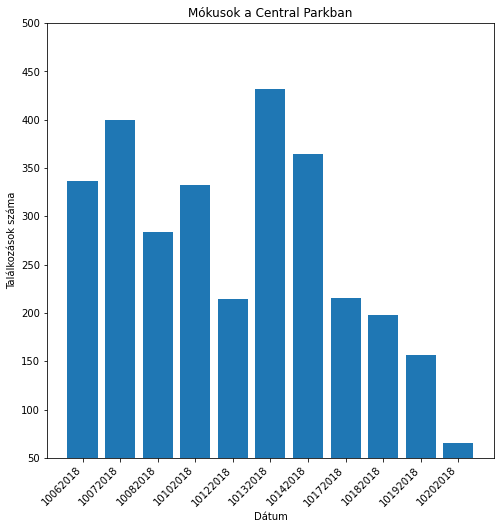

In [13]:
a=getcolumn('nyc_squirrels.csv',5)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True)
fig, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.bar(unique,counts)
labels = axs.get_xticklabels()
plt.setp(labels, rotation=45, horizontalalignment='right')
axs.set(ylim=[50, 500], ylabel='Találkozások száma', xlabel='Dátum',title='Mókusok a Central Parkban')
plt.show()

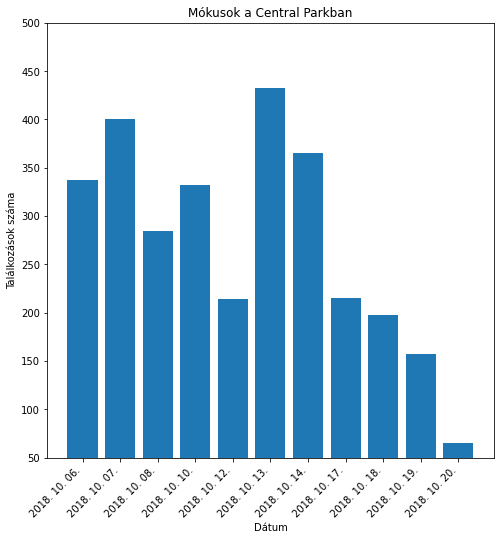

In [14]:
a=getcolumn('nyc_squirrels.csv',5)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True)
unique=[l[4:8]+". "+l[0:2]+". "+l[2:4]+"." for l in unique]
fig, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.bar(unique,counts)
labels = axs.get_xticklabels()
plt.setp(labels, rotation=45, horizontalalignment='right')
axs.set(ylim=[50, 500], ylabel='Találkozások száma', xlabel='Dátum',
       title='Mókusok a Central Parkban')
plt.show()

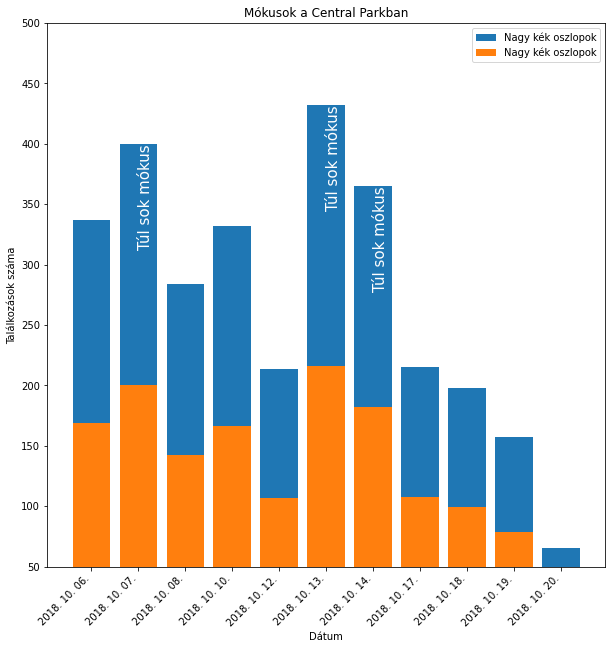

In [15]:
a=getcolumn('nyc_squirrels.csv',5)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True)
unique=[l[4:8]+". "+l[0:2]+". "+l[2:4]+"." for l in unique]

fig, axs = plt.subplots(1, 1, figsize=(10, 10))
axs.bar(unique,counts,label="Nagy kék oszlopok")
axs.bar(unique,[x/2 for x in counts],label="Nagy kék oszlopok")
labels = axs.get_xticklabels()
plt.setp(labels, rotation=45, horizontalalignment='right')
axs.set(ylim=[50, 500], ylabel='Találkozások száma', xlabel='Dátum',
       title='Mókusok a Central Parkban')

for group in [1,6,5]:
    axs.text( group, counts[group], "Túl sok mókus", fontsize=15,
            verticalalignment="top", rotation=90,color="white")
axs.legend()
plt.show()



# Diagram típusok 
## Oszlop diagram

Előnyök:
- Kategóriákra osztott adatokat tud jól megjeleníteni
- Könnyű értelmezni, az adatokat összehasonlítani

Hátrányok:
- Csak néhány kategória esetén néz ki jól
- Nem mutatja a kategórián belüli eloszlást


# Kördiagram

Előnyök:
- Könnyű értelmezni
- A rész/egész arányok bemutatására hatékony

Hátrányok:
- Sok kategória esetén nem látszik túl jól
- Csak egyszerű, pozitív adatra működik


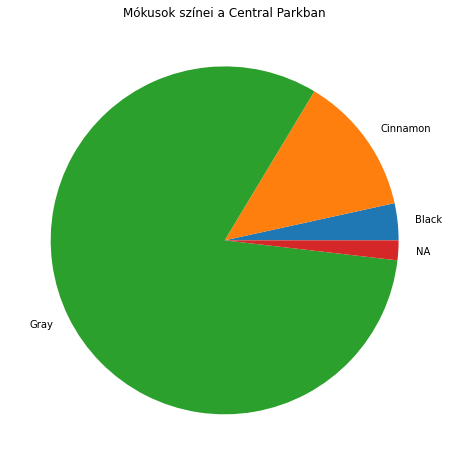

In [16]:
a=getcolumn('nyc_squirrels.csv',8)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True)

fig, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.pie(counts,labels=unique)
axs.set(title='Mókusok színei a Central Parkban')
plt.show()



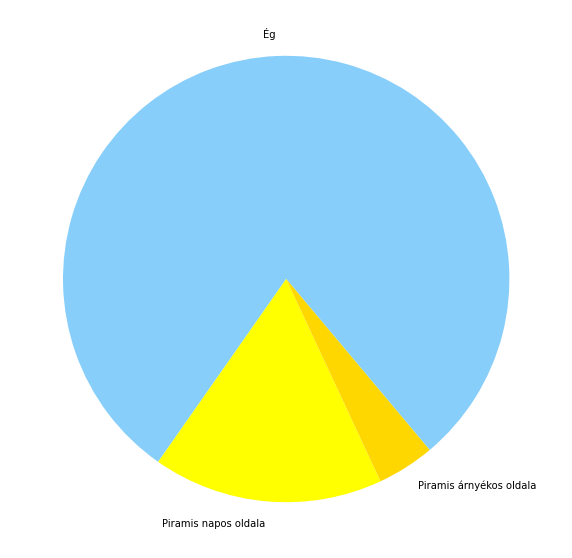

In [17]:
fig,ax = plt.subplots(1,1,figsize = (10,10))
ax.axis('equal')
langs = ['Ég', 'Piramis napos oldala', 'Piramis árnyékos oldala']
nums = [285/360,60/360,15/360]
colors=["lightskyblue","yellow","gold"]
ax.pie(nums, labels = langs, colors=colors,startangle=-50)
plt.show()

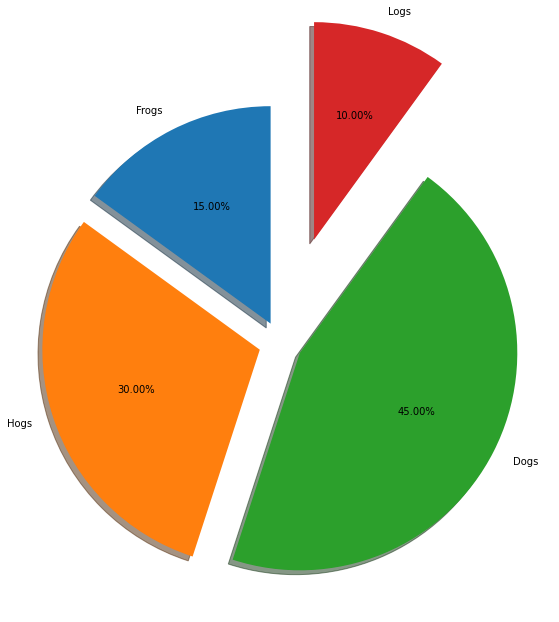

In [18]:
labels = ['Frogs', 'Hogs', 'Dogs', 'Logs']
sizes = [15, 30, 45, 10]
explode = (0.1, 0.1, 0.1, 0.5)  # melyik mennyire jöjjön ki

fig1, ax1 = plt.subplots(figsize=(10,10))
ax1.pie(sizes, explode=explode, labels=labels, autopct='%1.2f%%',
        shadow=True, startangle=90)
plt.show()

## Függvény

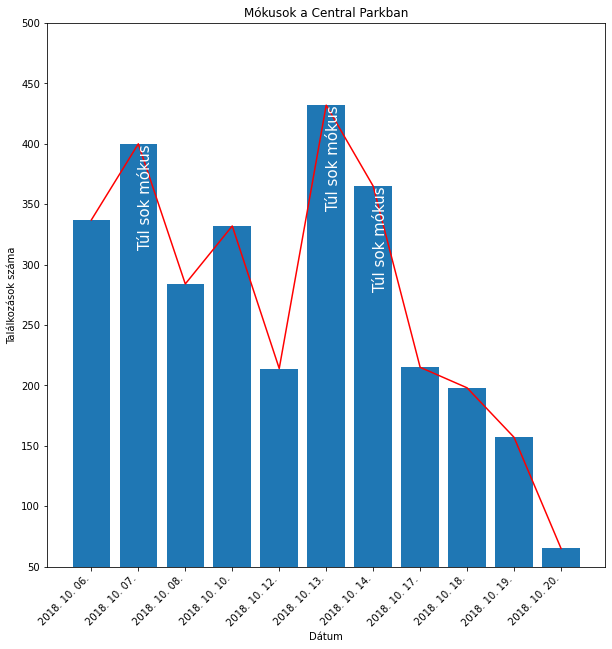

In [19]:
a=getcolumn('nyc_squirrels.csv',5)
num=np.array(a)
unique, counts = np.unique(num, return_counts=True)
unique=[l[4:8]+". "+l[0:2]+". "+l[2:4]+"." for l in unique]

fig, axs = plt.subplots(1, 1, figsize=(10, 10))
axs.bar(unique,counts)
labels = axs.get_xticklabels()
plt.setp(labels, rotation=45, horizontalalignment='right')
axs.set(ylim=[50, 500], ylabel='Találkozások száma', xlabel='Dátum',
       title='Mókusok a Central Parkban')

for group in [1,6,5]:
    axs.text( group, counts[group], "Túl sok mókus", fontsize=15,
            verticalalignment="top", rotation=90,color="white")
axs.plot(counts,color="red")
plt.show()

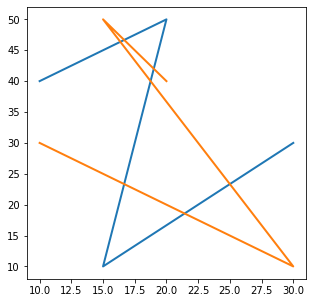

In [20]:
fig, axs = plt.subplots(1, 1, figsize=(5, 5))

plt.plot([10,20,15,30], [40,50,10,30], lw=2)
plt.plot([20,15,30,10], [40,50,10,30], lw=2)

plt.show()

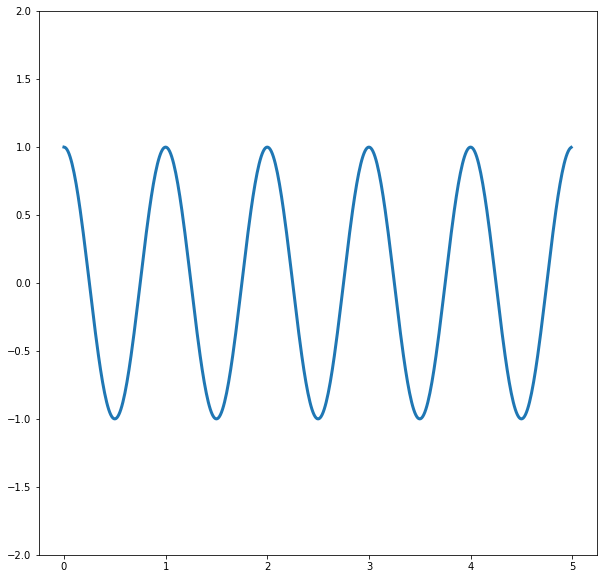

In [21]:
fig, axs = plt.subplots(1, 1, figsize=(10, 10))

t = np.arange(0.0, 5.0, 0.01)
s = np.cos(2*np.pi*t)
plt.plot(t, s, lw=3)
plt.ylim(-2, 2)
plt.show() 

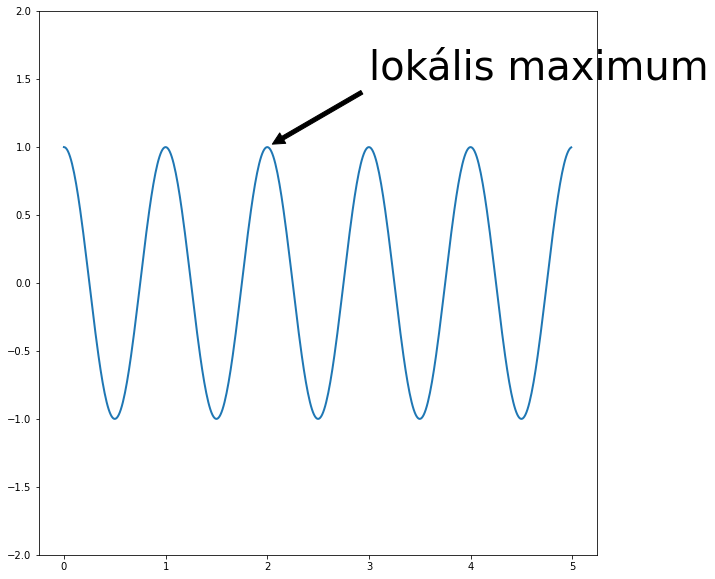

In [22]:
fig, axs = plt.subplots(1, 1, figsize=(10, 10))

t = np.arange(0.0, 5.0, 0.01)
s = np.cos(2*np.pi*t)
line, = plt.plot(t, s, lw=2)
 
axs.annotate('lokális maximum', xy=(2, 1), xytext=(3, 1.5),
             arrowprops=dict(facecolor='black', shrink=0.05), size=40
             )
plt.ylim(-2, 2)
plt.show()

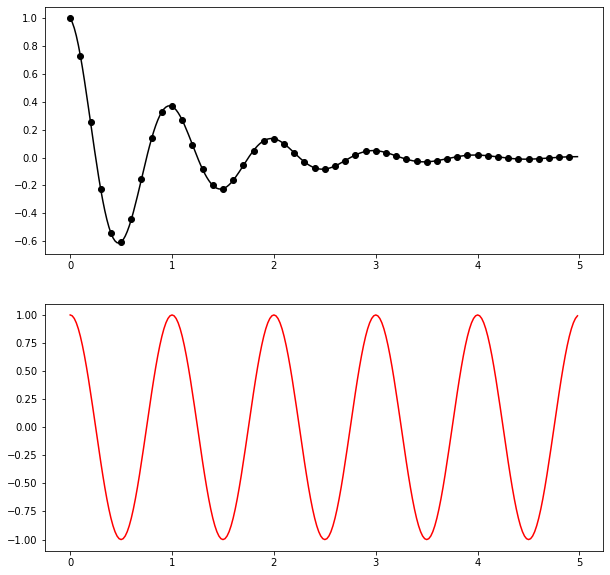

In [23]:
def f(t):
    return np.exp(-t) * np.cos(2*np.pi*t)

t1 = np.arange(0.0, 5.0, 0.1)
t2 = np.arange(0.0, 5.0, 0.02)

fig, axs = plt.subplots(2, 1, figsize=(10, 10))
axs[0].plot(t1, f(t1), 'ko')
axs[0].plot( t2, f(t2), 'k')
axs[1].plot(t2, np.cos(2*np.pi*t2), 'r-')
plt.show()

## Scatter plot
Pontokat rajzol, x-koordináta és y-koordináta tömb alapján. 

Előnyök:
- Két folyotonos adat közötti összefüggések ábrázolására hatékony
- Jól látszanak a trendek és a klaszterek

Hátrányok:
- Túl sok adat esetén nem jól látható

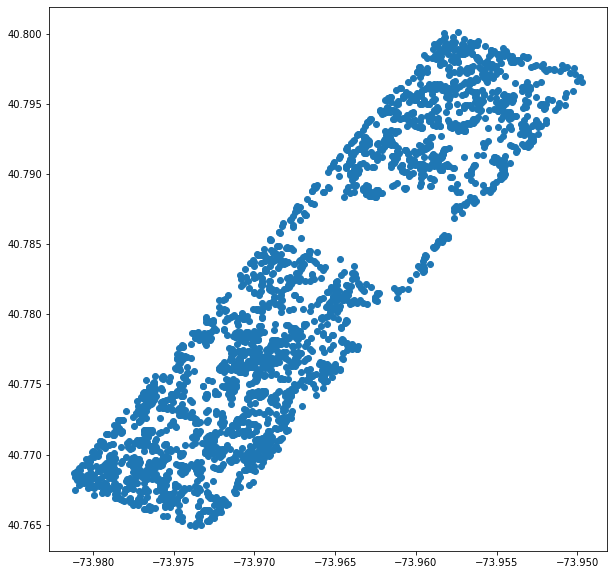

In [24]:
xpos=getcolumn('nyc_squirrels.csv',0)
ypos=getcolumn('nyc_squirrels.csv',1)
xpos=np.array([float(a) for a in xpos])
ypos=np.array([float(a) for a in ypos])

fig, axs = plt.subplots(1, 1, figsize=(10, 10))
axs.scatter(xpos,ypos)
plt.show()

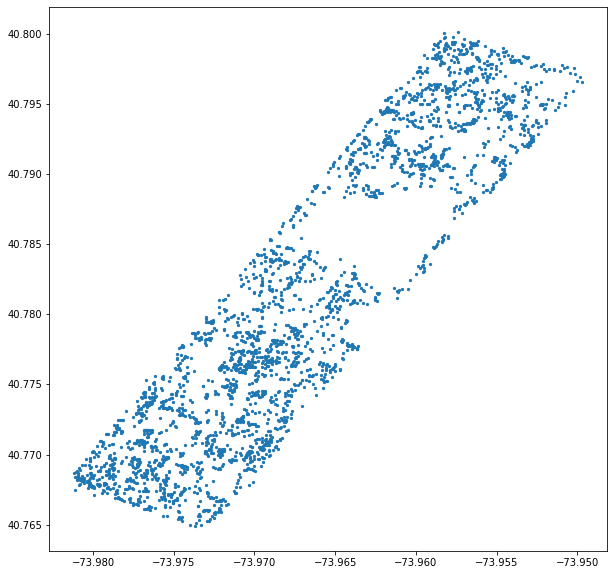

In [25]:
xpos=getcolumn('nyc_squirrels.csv',0)
ypos=getcolumn('nyc_squirrels.csv',1)
xpos=np.array([float(a) for a in xpos])
ypos=np.array([float(a) for a in ypos])

fig, axs = plt.subplots(1, 1, figsize=(10, 10)) 
axs.scatter(xpos,ypos,s=5)
plt.show()

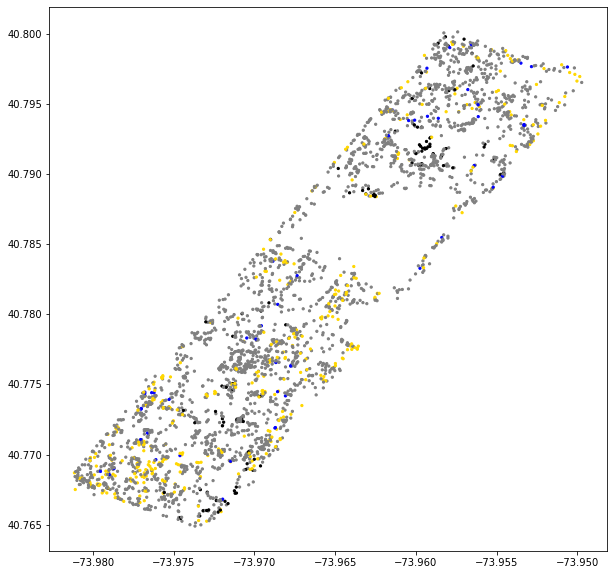

In [26]:
xpos=getcolumn('nyc_squirrels.csv',0)
ypos=getcolumn('nyc_squirrels.csv',1)
xpos=np.array([float(a) for a in xpos])
ypos=np.array([float(a) for a in ypos])

col=getcolumn('nyc_squirrels.csv',8)
def colorpicker(c):
    if c=='Gray': return "gray"
    if c=='Cinnamon': return "gold"
    if c=='Black': return "black"
    return 'blue'
    
colors=[colorpicker(a) for a in col]

fig, axs = plt.subplots(1, 1, figsize=(10, 10))
axs.scatter(xpos,ypos,s=5,c=colors)
plt.show()

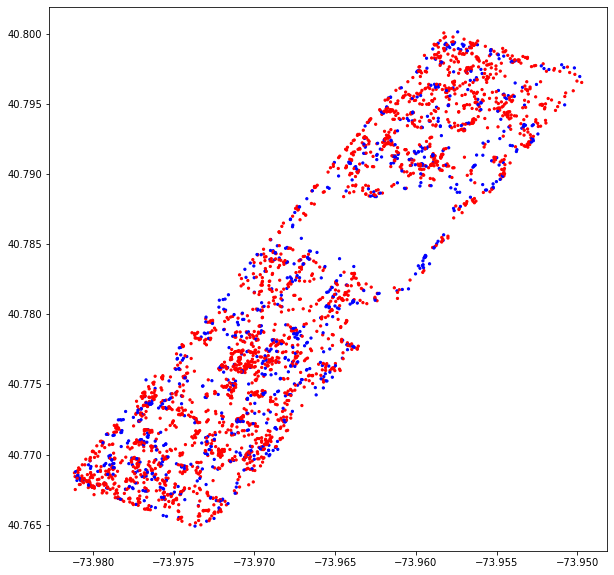

In [27]:
xpos=getcolumn('nyc_squirrels.csv',0)
ypos=getcolumn('nyc_squirrels.csv',1)
xpos=np.array([float(a) for a in xpos])
ypos=np.array([float(a) for a in ypos])

col=getcolumn('nyc_squirrels.csv',12)
def colorpicker(c):
    if c=='Above Ground': return "blue"
    return 'red'
    
colors=[colorpicker(a) for a in col]

fig, axs = plt.subplots(1, 1, figsize=(10, 10)) 
axs.scatter(xpos,ypos,s=5,c=colors)
plt.show()

## Kitérő: Térkép


In [7]:
import folium      # egy a sok térképmegjelenítő közül

In [8]:
xpos=getcolumn('nyc_squirrels.csv',0)
ypos=getcolumn('nyc_squirrels.csv',1)
xpos=np.array([float(a) for a in xpos])
ypos=np.array([float(a) for a in ypos])

coords=list(zip(ypos,xpos))

#New York koordinátái
NYC_COORD = [40.7828, -73.970]

# Térkép létrehozása
map_nyc = folium.Map(location=NYC_COORD, zoom_start=13,  width=1000, height=800)

# Pontok kirajzolása comprehension segítségével
[folium.CircleMarker(coords[i], radius=1,
                color='#0080bb', fill_color='#0080bb').add_to(map_nyc) 
for i in range(len(coords))]

# Térkép megjelenítés
map_nyc



In [38]:

megyek = (    "counties.geojson")
m = folium.Map(location=(47.2, 20), zoom_start=7., tiles="cartodb positron")
folium.GeoJson(megyek).add_to(m)

m

In [39]:

iranyitoszam = ("postal_codes.geojson")
m = folium.Map(location=(47.2, 20), zoom_start=7., tiles="cartodb positron")
folium.GeoJson(iranyitoszam).add_to(m)

m

## Hisztogram
Előnyök:
- Egy darab folytonos adat eloszlásának bemutatására használható
- Átlagolja az adatot, így a trendek jobban megjelennek 

Hátrányok:
- Félrevezető lehet, sok múlik a beosztáson

A `party.csv` New Yorki csendháborítások adatait tartalmazza. 

In [52]:
hour=getcolumn('party.csv',0)


In [53]:
hour[0:10]

['2015-12-31 00:01:15',
 '2015-12-31 00:02:48',
 '2015-12-31 00:03:25',
 '2015-12-31 00:03:26',
 '2015-12-31 00:05:10',
 '2015-12-31 00:08:05',
 '2015-12-31 00:11:40',
 '2015-12-31 00:12:13',
 '2015-12-31 00:12:37',
 '2015-12-31 00:14:13']

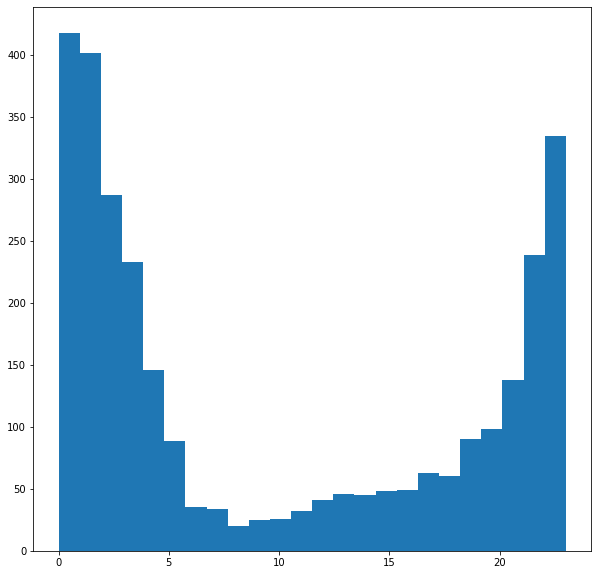

In [54]:
hour=getcolumn('party.csv',0)
hour=[ int(row[11])*10+int(row[12]) for row in hour]
fig, axs = plt.subplots(1, 1, figsize=(10,10))
plt.hist(hour,bins=24)
plt.show()

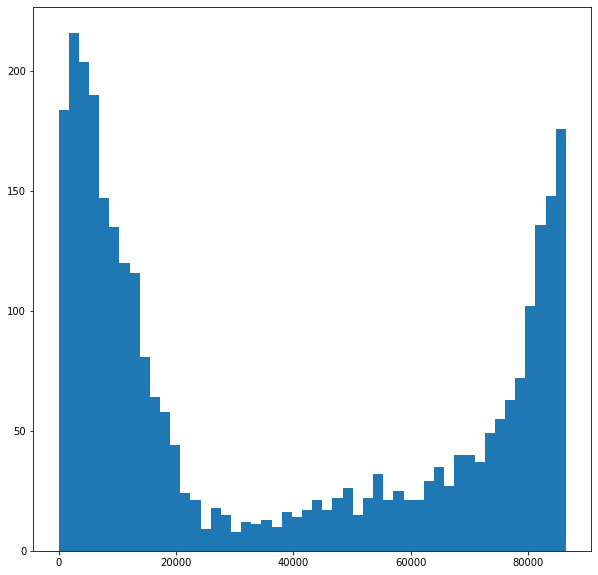

In [56]:
hour=getcolumn('party.csv',0)
hour=[ (int(row[11])*10+int(row[12]))*3600+(int(row[14])*10+int(row[15]))*60+int(row[17])*10+int(row[18]) for row in hour]
fig, axs = plt.subplots(1, 1, figsize=(10, 10))
plt.hist(hour,bins=50)
plt.show()

In [41]:
xpos=getcolumn('party.csv',6)
ypos=getcolumn('party.csv',7)

xpos=np.array([float(a) for a in xpos if len(a)>0])
ypos=np.array([float(a) for a in ypos if len(a)>0])

NYC_COORD = [40.7128, -74.0059]

coords=list(zip(xpos,ypos))

map_nyc = folium.Map(location=NYC_COORD, zoom_start=12, 
 width=1000, height=800)

[folium.CircleMarker(coords[i], radius=1,
                color='#0080bb', fill_color='#0080bb').add_to(map_nyc) 
for i in range(len(coords))]

map_nyc

### Mentés képként
`plt.savefig("nev.png")`

### További példák: https://matplotlib.org/gallery/index.html

## Seaborn
- matpoltlib alapú
- magasabb szintű

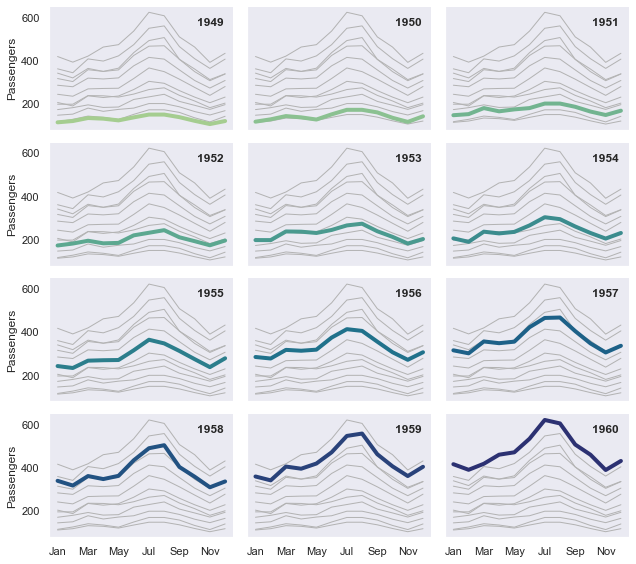

In [53]:
import seaborn as sns

sns.set_theme(style="dark")
flights = sns.load_dataset("flights")

# Plot each year's time series in its own facet
g = sns.relplot(
    data=flights,
    x="month", y="passengers", col="year", hue="year",
    kind="line", palette="crest", linewidth=4, zorder=5,
    col_wrap=3, height=2, aspect=1.5, legend=False,
)

# Iterate over each subplot to customize further
for year, ax in g.axes_dict.items():

    # Add the title as an annotation within the plot
    ax.text(.8, .85, year, transform=ax.transAxes, fontweight="bold")

    # Plot every year's time series in the background
    sns.lineplot(
        data=flights, x="month", y="passengers", units="year",
        estimator=None, color=".7", linewidth=1, ax=ax,
    )

# Reduce the frequency of the x axis ticks
ax.set_xticks(ax.get_xticks()[::2])

# Tweak the supporting aspects of the plot
g.set_titles("")
g.set_axis_labels("", "Passengers")
g.tight_layout()

A szokásos matplotlibes plotok elérhetőek

A "tips" egy beépített adathalmaz, néhány nap borravalóiról tartalmaz adatokat.

|total_bill|tip                          |sex   |smoker                                       |day|time  |size|
|----------|-----------------------------|------|---------------------------------------------|---|------|----|
|16.99     |1.01                         |Female|No                                           |Sun|Dinner|2   |
|10.34     |1.66                         |Male  |No                                           |Sun|Dinner|3   |

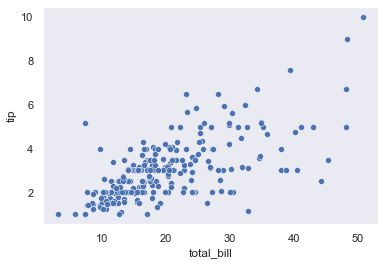

In [45]:
import seaborn as sns
import matplotlib.pyplot as plt
# Sample data
tips = sns.load_dataset("tips")
# Basic scatter plot
sns.scatterplot(x='total_bill', y='tip', data=tips)
plt.show()

### boxplot
Előnyök
- min, max, negyedek, medián könnyen leolvasható
- Több adathalmaz összehasonítására is megfelelő

Hátrányok:
- Nem mutatja a belső eloszlást pontosan

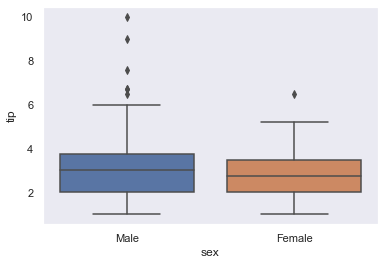

In [48]:
sns.boxplot(x='sex', y='tip', data=tips)
plt.show()

### violin plot
Előnyök:
- Teljes eloszlás látszik

Hátrányok:
- Nehezebben értelmezhető

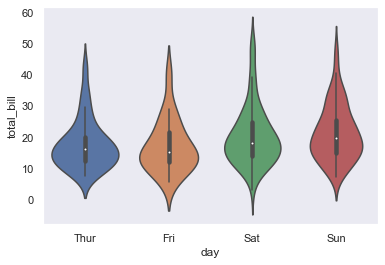

In [54]:
sns.violinplot(x='day', y='total_bill', data=tips)
plt.show()

### pair plot
Előnyök:
- Több változó közötti összefüggésre is rá tud mutatni

Hátrányok:
- Túl sok változó esetén olvashatatlan


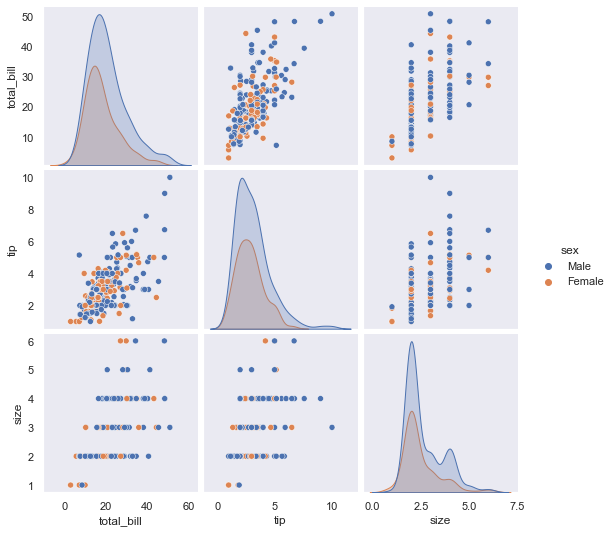

In [50]:
sns.pairplot(tips, hue='sex')
plt.show()

### heatmap és korreláció

- szín az értékek alapján
- korreláció értékek megmutatására hatékony



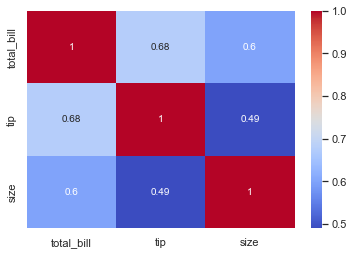

In [51]:
import numpy as np
corr = tips.corr()
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.show()